# Error Analysis before Primary Feature Work

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import altair as alt
import warnings
import seaborn as sns
import os as os
from datetime import date
from datetime import datetime


from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor
from sklearn import preprocessing
from sklearn.linear_model import LinearRegression
from sklearn.impute import SimpleImputer
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import VotingRegressor
from sklearn.model_selection import cross_val_score
from sklearn import metrics
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import BayesianRidge
import lightgbm as lgb
import xgboost as xgb

%matplotlib inline
warnings.filterwarnings('ignore')
pd.options.display.float_format = '{:.2f}'.format

import pickle
br_model = pickle.load(open('br_model', 'rb'))



/Users/travismetz/anaconda3/lib/python3.7/site-packages/lightgbm/__init__.py:48: UserWarning: Starting from version 2.2.1, the library file in distribution wheels for macOS is built by the Apple Clang (Xcode_8.3.3) compiler.
This means that in case of installing LightGBM from PyPI via the ``pip install lightgbm`` command, you don't need to install the gcc compiler anymore.
Instead of that, you need to install the OpenMP library, which is required for running LightGBM on the system with the Apple Clang compiler.
You can install the OpenMP library by the following command: ``brew install libomp``.
  "You can install the OpenMP library by the following command: ``brew install libomp``.", UserWarning)


In [3]:
results=pd.read_csv('results.csv')
results
results['actual_price']=np.exp(results.actual)
results['predicted_price']=np.exp(results.predicted)

In [4]:
results['error']=results.actual-results.predicted
#so error is positive if actual is more than predicted
#error is negative if actual is LESS THAN predicted

In [5]:
results.sort_values(['error'],ascending=False,inplace=True)
results.error

963     0.45
682     0.38
675     0.30
326     0.29
732     0.28
        ... 
1313   -0.61
459    -0.61
492    -0.65
627    -0.67
30     -0.76
Name: error, Length: 1449, dtype: float64

In [9]:
threshold=110000
results['PriceSplit']=[x<threshold for x in results.actual_price]
results.PriceSplit
print(sum(results.PriceSplit),len(results.PriceSplit))
results.groupby('PriceSplit').error.mean()

172 1449


PriceSplit
False    0.01
True    -0.07
Name: error, dtype: float64

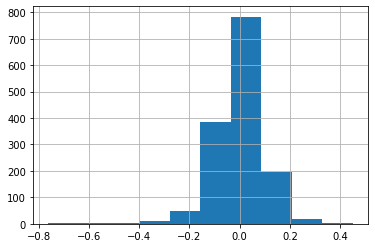

In [44]:
results.error.hist()

In [50]:
results[-10:].describe()

,actual,predicted,GrLivArea,MasVnrArea,BsmtCond,LotFrontage,1stFlrSF,BsmtFinSF2,ExterCond,OpenPorchSF,...,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial,actual_price,predicted_price,error
count,5.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00,...,5.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00,5.00
mean,11.06,11.72,1221.40,127.40,3.00,66.00,1087.80,62.20,3.00,125.20,...,0.00,0.80,0.00,0.00,0.20,0.40,0.20,73356.60,139660.48,-0.66
std,0.58,0.55,433.95,190.86,0.00,13.87,495.61,139.08,0.71,223.87,...,0.00,0.45,0.00,0.00,0.45,0.55,0.45,45329.20,80742.70,0.06
min,10.46,11.11,720.00,0.00,3.00,50.00,649.00,0.00,2.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,34900.00,67103.42,-0.76
25%,10.60,11.36,864.00,0.00,3.00,60.00,720.00,0.00,3.00,0.00,...,0.00,1.00,0.00,0.00,0.00,0.00,0.00,40000.00,85669.97,-0.67
50%,11.04,11.65,1317.00,0.00,3.00,60.00,864.00,0.00,3.00,49.00,...,0.00,1.00,0.00,0.00,0.00,0.00,0.00,62383.00,114612.35,-0.65
75%,11.32,11.99,1411.00,209.00,3.00,75.00,1411.00,0.00,3.00,54.00,...,0.00,1.00,0.00,0.00,0.00,1.00,0.00,82500.00,161699.65,-0.61
max,11.90,12.50,1795.00,428.00,3.00,85.00,1795.00,311.00,4.00,523.00,...,0.00,1.00,0.00,0.00,1.00,1.00,1.00,147000.00,269217.03,-0.61


In [53]:
results[0:-10].describe()

,actual,predicted,GrLivArea,MasVnrArea,BsmtCond,LotFrontage,1stFlrSF,BsmtFinSF2,ExterCond,OpenPorchSF,...,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial,actual_price,predicted_price,error
count,1439.00,1439.00,1439.00,1439.00,1439.00,1439.00,1439.00,1439.00,1439.00,1439.00,...,1439.00,1439.00,1439.00,1439.00,1439.00,1439.00,1439.00,1439.00,1439.00,1439.00
mean,12.03,12.03,1515.01,102.86,2.94,70.03,1159.61,47.01,3.09,46.28,...,0.00,0.87,0.00,0.01,0.01,0.83,0.08,181823.29,180543.80,0.00
std,0.39,0.38,508.22,179.70,0.55,21.57,372.13,162.25,0.35,64.38,...,0.05,0.34,0.05,0.08,0.11,0.38,0.28,78999.43,76393.51,0.09
min,10.58,10.85,334.00,0.00,0.00,21.00,334.00,0.00,1.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,39300.00,51398.38,-0.38
25%,11.78,11.76,1133.00,0.00,3.00,60.00,882.00,0.00,3.00,0.00,...,0.00,1.00,0.00,0.00,0.00,1.00,0.00,130000.00,127747.94,-0.05
50%,12.01,12.00,1469.00,0.00,3.00,70.00,1086.00,0.00,3.00,25.00,...,0.00,1.00,0.00,0.00,0.00,1.00,0.00,164000.00,162667.86,0.00
75%,12.27,12.27,1779.00,164.50,3.00,80.00,1391.00,0.00,3.00,68.00,...,0.00,1.00,0.00,0.00,0.00,1.00,0.00,214250.00,213280.43,0.06
max,13.53,13.57,4476.00,1600.00,4.00,313.00,3228.00,1474.00,5.00,547.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,755000.00,779815.76,0.45


In [ ]:
#largest errors are when sale price is low

In [ ]:
results[PriceSplit]=

In [55]:
results.actual_price[0:5]

963   135000.00
682   392000.00
675   159434.00
326   214500.00
732   179000.00
Name: actual_price, dtype: float64

In [64]:
threshold=110000
results['PriceSplit']=[x<threshold for x in results.actual_price]
results.PriceSplit
results.groupby('PriceSplit').error.mean()

PriceSplit
False    0.01
True    -0.07
Name: error, dtype: float64

In [65]:
results[0:10].describe()

,actual,predicted,GrLivArea,MasVnrArea,BsmtCond,LotFrontage,1stFlrSF,BsmtFinSF2,ExterCond,OpenPorchSF,...,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial,actual_price,predicted_price,error
count,10.00,10.00,10.00,10.00,10.00,10.00,10.00,10.00,10.00,10.00,...,10.00,10.00,10.00,10.00,10.00,10.00,10.00,10.00,10.00,10.00
mean,12.28,11.99,1595.50,87.30,3.00,70.60,1231.70,0.00,2.90,27.70,...,0.00,0.60,0.00,0.10,0.00,0.30,0.30,242993.40,181381.99,0.30
std,0.53,0.54,328.20,147.71,0.47,20.40,391.17,0.00,0.57,40.72,...,0.00,0.52,0.00,0.32,0.00,0.48,0.48,118694.77,89842.58,0.07
min,11.35,11.10,1192.00,0.00,2.00,51.00,720.00,0.00,2.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,85000.00,66449.84,0.24
25%,11.99,11.70,1393.50,0.00,3.00,60.00,935.75,0.00,3.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,161075.50,120832.42,0.26
50%,12.19,11.90,1523.00,0.00,3.00,62.00,1168.50,0.00,3.00,0.00,...,0.00,1.00,0.00,0.00,0.00,0.00,0.00,196750.00,148354.11,0.27
75%,12.82,12.48,1878.50,139.50,3.00,70.75,1438.50,0.00,3.00,51.00,...,0.00,1.00,0.00,0.00,0.00,0.75,0.75,371875.00,262093.07,0.29
max,12.89,12.63,2134.00,375.00,4.00,110.00,1973.00,0.00,4.00,119.00,...,0.00,1.00,0.00,1.00,0.00,1.00,1.00,395000.00,306590.19,0.45


In [66]:
results.describe()

,actual,predicted,GrLivArea,MasVnrArea,BsmtCond,LotFrontage,1stFlrSF,BsmtFinSF2,ExterCond,OpenPorchSF,...,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial,actual_price,predicted_price,error
count,1449.00,1449.00,1449.00,1449.00,1449.00,1449.00,1449.00,1449.00,1449.00,1449.00,...,1449.00,1449.00,1449.00,1449.00,1449.00,1449.00,1449.00,1449.00,1449.00,1449.00
mean,12.03,12.03,1512.50,102.59,2.94,70.00,1158.83,46.90,3.08,46.43,...,0.00,0.87,0.00,0.01,0.01,0.82,0.08,181030.63,180100.92,0.00
std,0.40,0.38,507.95,179.47,0.55,21.52,372.13,161.88,0.35,65.44,...,0.05,0.34,0.05,0.08,0.12,0.38,0.28,79341.15,76465.65,0.10
min,10.46,10.85,334.00,0.00,0.00,21.00,334.00,0.00,1.00,0.00,...,0.00,0.00,0.00,0.00,0.00,0.00,0.00,34900.00,51398.38,-0.76
25%,11.78,11.76,1131.00,0.00,3.00,60.00,882.00,0.00,3.00,0.00,...,0.00,1.00,0.00,0.00,0.00,1.00,0.00,130000.00,127587.56,-0.05
50%,12.00,12.00,1466.00,0.00,3.00,70.00,1086.00,0.00,3.00,25.00,...,0.00,1.00,0.00,0.00,0.00,1.00,0.00,163000.00,162051.60,0.00
75%,12.27,12.27,1776.00,164.00,3.00,80.00,1391.00,0.00,3.00,68.00,...,0.00,1.00,0.00,0.00,0.00,1.00,0.00,214000.00,212176.20,0.06
max,13.53,13.57,4476.00,1600.00,4.00,313.00,3228.00,1474.00,5.00,547.00,...,1.00,1.00,1.00,1.00,1.00,1.00,1.00,755000.00,779815.76,0.45


### pca with error as color

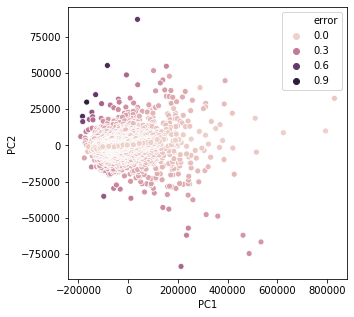

In [27]:
from sklearn.preprocessing import StandardScaler
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA


scaler=StandardScaler()
results_pca=results.drop(['predicted','actual','error'],axis=1)
results_pca_normalized=scaler.fit_transform(results_pca)


def PCA_function(data):
    
    pca=PCA(n_components=2)
    reduced_results=pca.fit_transform(data)
    
    for n_clusters in [3]:
        kmeans=KMeans(n_clusters=n_clusters,random_state=0)
        kmeans.fit(reduced_results)
        colors = ["g", "r"]
        fig, ax = plt.subplots(figsize=(5, 5))
        X, Y = reduced_results[:, 0], reduced_results[:, 1]
        sns.scatterplot(x=X, y=Y, hue=results.error)
        ax.set_xlabel("PC1")
        ax.set_ylabel("PC2")
        
        #for i in range(n_clusters):
        #    radii = cdist(reduced_train_data[kmeans.labels_ == i], [kmeans.cluster_centers_[i]], metric="euclidean").max()
        #    circle = plt.Circle(kmeans.cluster_centers_[i], radii, color="#00000000", ec="blue")
        #    ax.add_patch(circle)
        #    plt.text(kmeans.cluster_centers_[i][0]-0.25,kmeans.cluster_centers_[i][1]-0.25,str(i+1),color="black",size=30)
        
        #ax.set_title("6-Mean Clusters")
        ax.set_xlabel("PC1")
        ax.set_ylabel("PC2")
    #plt.show()
PCA_function(results_pca)

In [5]:
error_corr=results[results.columns[:]].corr()['error'][:]
np.absolute(error_corr).sort_values(ascending=False).head(20)

error                  1.00
SaleCondition_Normal   0.22
CentralAir_Y           0.20
YearBuilt              0.19
actual                 0.19
GarageCond             0.18
GarageYrBlt            0.17
GarageFinish_None      0.16
GarageType_None        0.16
GarageQual             0.16
Neighborhood_IDOTRR    0.15
HeatingQC              0.14
Foundation_PConc       0.13
OverallQual            0.13
predicted              0.13
MSSubClass_30          0.13
PavedDrive_Y           0.13
Heating_Grav           0.12
YearRemodAdd           0.12
Neighborhood_CollgCr   0.12
Name: error, dtype: float64

In [6]:
source=results

alt_chart=alt.Chart(source).mark_circle(size=60).encode(
    x='actual_price',
    y='error',
    #color='SaleCondition_Normal',
    tooltip=['actual_price','predicted_price']).properties(
    width=800,
    height=300)#.interactive()

alt_chart+alt_chart.transform_regression('actual_price','error').mark_line(color="red")

alt.LayerChart(...)

In [7]:
source=results

alt_chart=alt.Chart(source).mark_circle(size=60).encode(
    alt.X('YearBuilt',
        scale=alt.Scale(zero=False)),
    y='error',
    #color='actual_price',
    tooltip=['actual_price','predicted_price']
    ).properties(
    width=800,
    height=300
    )#.interactive()

#regression lines don't work well with interactive or colors?

alt_chart+alt_chart.transform_regression('YearBuilt','error').mark_line(color="red")

alt.LayerChart(...)

In [8]:
results.OverallQual.value_counts()

5.00     396
6.00     373
7.00     317
8.00     168
4.00     114
9.00      42
3.00      20
10.00     16
2.00       2
1.00       1
Name: OverallQual, dtype: int64

In [9]:
source=results

alt_chart=alt.Chart(source).mark_circle(size=60).encode(
    x='OverallQual:O',
    y='error',
    #color='actual_price',
    tooltip=['actual_price','predicted_price']
    ).properties(
    width=800,
    height=300
    )#.interactive()
alt_chart

alt.Chart(...)